# **Wine Quality Dataset**

### *Preparing the dataset*

In [72]:
# Import all librabries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from graphviz import Source
from IPython.display import Image, display
import os

In [73]:
# Load the Wine Quality dataset from the CSV file
wine_data = pd.read_csv('winequality-white.csv', delimiter=';')

# Feature columns (Input variables)
X = wine_data.drop(columns=['quality'])

# Output column (Target variable)
y = wine_data['quality']

# 2.1: Grouping quality into categories
def categorize_quality(quality):
    if quality <= 4:
        return 'Low Quality'
    elif quality <= 6:
        return 'Standard Quality'
    else:
        return 'High Quality'

y = y.apply(categorize_quality)

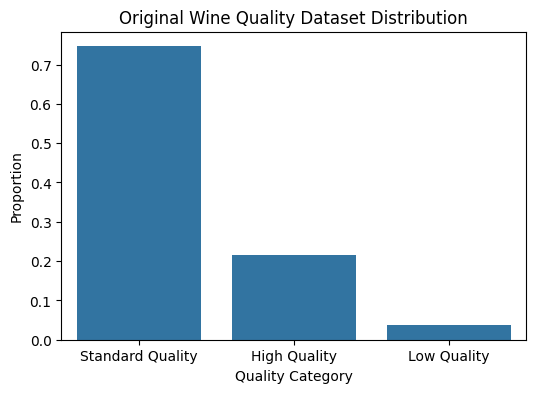

In [74]:
# Visualizing class distribution in the original dataset
original_dist = y.value_counts(normalize=True)
plt.figure(figsize=(6, 4))
sns.barplot(x=original_dist.index, y=original_dist.values)
plt.title("Original Wine Quality Dataset Distribution")
plt.xlabel("Quality Category")
plt.ylabel("Proportion")
plt.show()

In [87]:
def split_and_visualize(X, y, train_size):
    # Perform stratified splitting
    feature_train, feature_test, label_train, label_test = train_test_split(
        X, y, train_size=train_size, stratify=y, random_state=42
    )

    # Visualize class distribution
    train_dist = label_train.value_counts(normalize=True)
    test_dist = label_test.value_counts(normalize=True)

    print(f"Training set distribution (Train size = {train_size}):")
    print(train_dist)
    print(f"Test set distribution (Train size = {train_size}):")
    print(test_dist)

    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    sns.barplot(x=train_dist.index, y=train_dist.values, ax=ax[0])
    ax[0].set_title("Training Set Distribution")
    sns.barplot(x=test_dist.index, y=test_dist.values, ax=ax[1])
    ax[1].set_title("Test Set Distribution")
    plt.show()

    return feature_train, feature_test, label_train, label_test


--- Train/Test Split: 40/60 ---

--- Raw Counts for Train/Test Split 40/60 ---
Training set raw counts:
quality
Standard Quality    1462
High Quality         424
Low Quality           73
Name: count, dtype: int64
Test set raw counts:
quality
Standard Quality    2193
High Quality         636
Low Quality          110
Name: count, dtype: int64

--- Normalized Distributions for Train/Test Split 40/60 ---
Training set normalized distribution:
quality
Standard Quality    0.746299
High Quality        0.216437
Low Quality         0.037264
Name: proportion, dtype: float64
Test set normalized distribution:
quality
Standard Quality    0.746172
High Quality        0.216400
Low Quality         0.037428
Name: proportion, dtype: float64


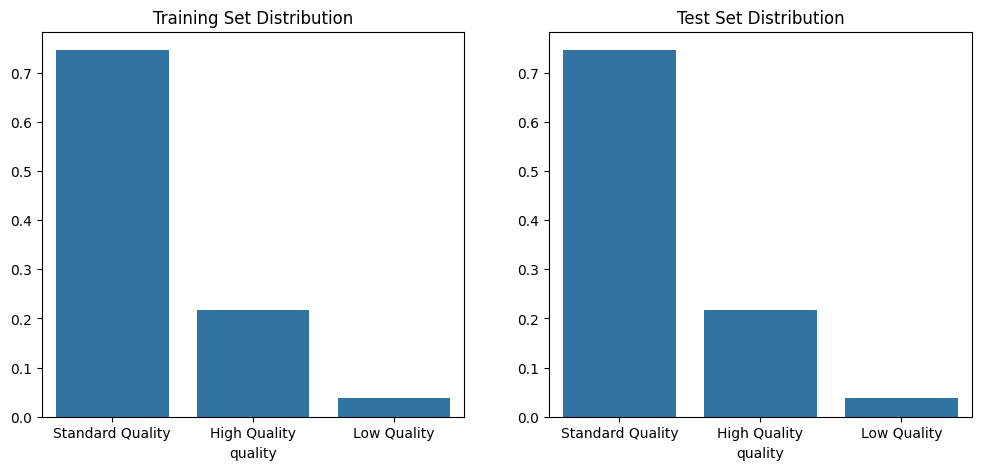


--- Train/Test Split: 60/40 ---

--- Raw Counts for Train/Test Split 60/40 ---
Training set raw counts:
quality
Standard Quality    2192
High Quality         636
Low Quality          110
Name: count, dtype: int64
Test set raw counts:
quality
Standard Quality    1463
High Quality         424
Low Quality           73
Name: count, dtype: int64

--- Normalized Distributions for Train/Test Split 60/40 ---
Training set normalized distribution:
quality
Standard Quality    0.746086
High Quality        0.216474
Low Quality         0.037440
Name: proportion, dtype: float64
Test set normalized distribution:
quality
Standard Quality    0.746429
High Quality        0.216327
Low Quality         0.037245
Name: proportion, dtype: float64


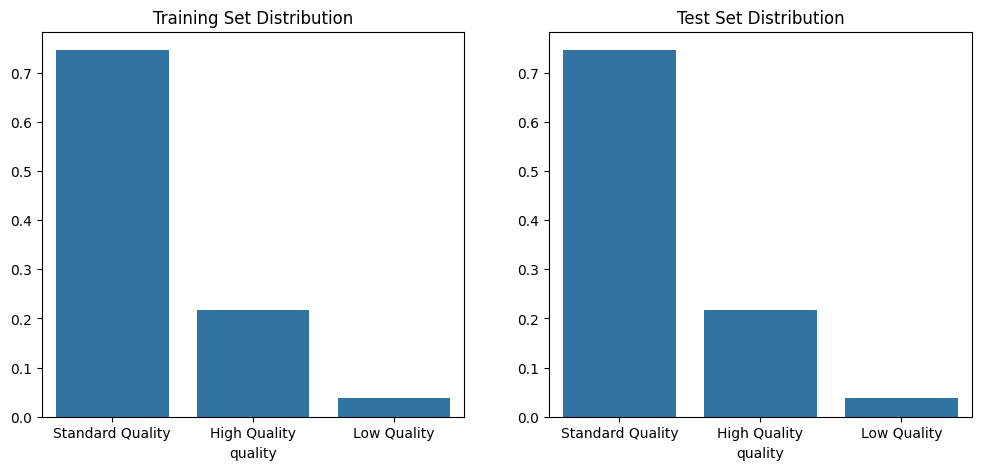


--- Train/Test Split: 80/20 ---

--- Raw Counts for Train/Test Split 80/19 ---
Training set raw counts:
quality
Standard Quality    2924
High Quality         848
Low Quality          146
Name: count, dtype: int64
Test set raw counts:
quality
Standard Quality    731
High Quality        212
Low Quality          37
Name: count, dtype: int64

--- Normalized Distributions for Train/Test Split 80/19 ---
Training set normalized distribution:
quality
Standard Quality    0.746299
High Quality        0.216437
Low Quality         0.037264
Name: proportion, dtype: float64
Test set normalized distribution:
quality
Standard Quality    0.745918
High Quality        0.216327
Low Quality         0.037755
Name: proportion, dtype: float64


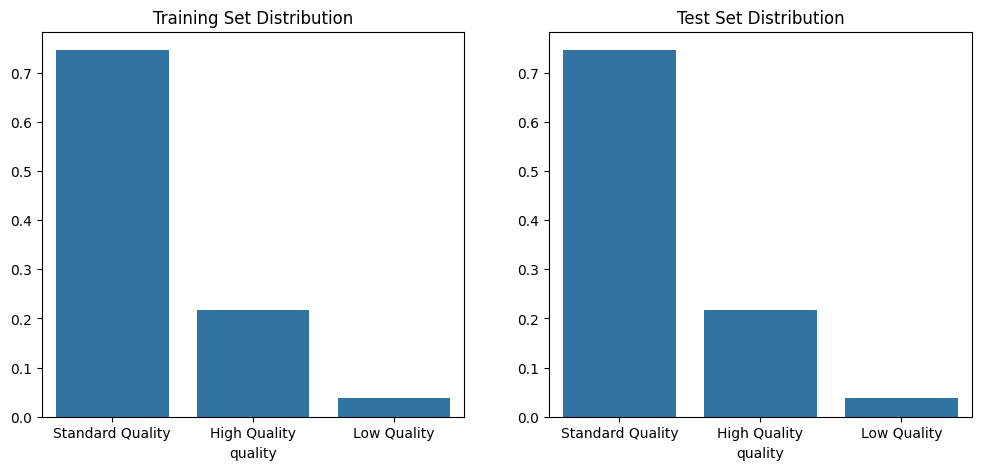


--- Train/Test Split: 90/10 ---

--- Raw Counts for Train/Test Split 90/9 ---
Training set raw counts:
quality
Standard Quality    3289
High Quality         954
Low Quality          165
Name: count, dtype: int64
Test set raw counts:
quality
Standard Quality    366
High Quality        106
Low Quality          18
Name: count, dtype: int64

--- Normalized Distributions for Train/Test Split 90/9 ---
Training set normalized distribution:
quality
Standard Quality    0.746143
High Quality        0.216425
Low Quality         0.037432
Name: proportion, dtype: float64
Test set normalized distribution:
quality
Standard Quality    0.746939
High Quality        0.216327
Low Quality         0.036735
Name: proportion, dtype: float64


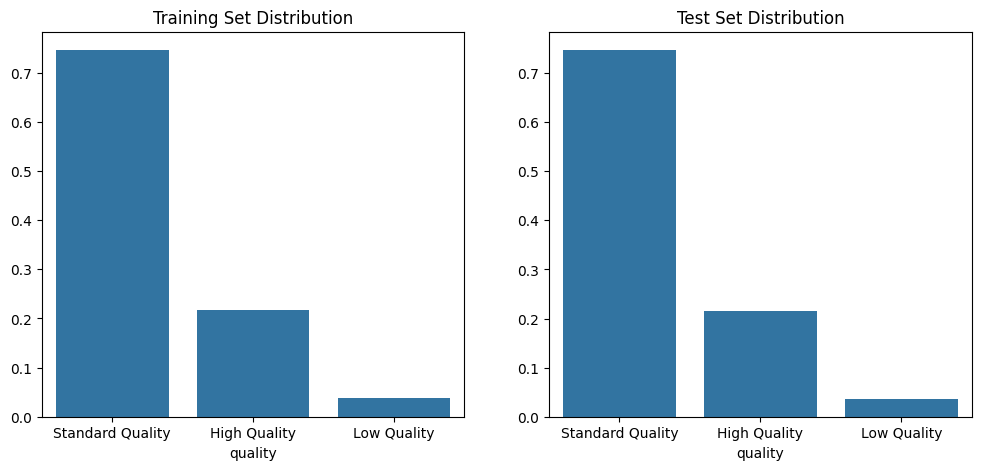

In [88]:
splits = [0.4, 0.6, 0.8, 0.9]

# Store the subsets
datasets = []

# Store the subsets
for split in splits:
    print(f"\n--- Train/Test Split: {int(round(split*100))}/{int(round((1-split)*100))} ---")
    feature_train, feature_test, label_train, label_test = split_and_visualize(X, y, split)
    datasets.append({
        "train_size": split,
        "feature_train": feature_train,
        "label_train": label_train,
        "feature_test": feature_test,
        "label_test": label_test
    })

### *Building the decision tree classifier*

In [77]:
# Define the folder where images will be saved
output_folder = "WQ_dataset_decision_trees"
os.makedirs(output_folder, exist_ok=True)  # Create the folder if it doesn't exist

In [78]:
def train_and_visualize_decision_tree(feature_train, label_train, train_size, output_folder) -> tuple:
    # Ensure the label is a pandas Series
    if isinstance(label_train, pd.DataFrame):
        label_train = label_train.squeeze()

    # Initialize the classifier
    clf = DecisionTreeClassifier(criterion='entropy', random_state=42)
    clf.fit(feature_train, label_train)

    # Get the depth of the trained tree
    tree_depth = clf.get_depth()

    # Sort the class names to match their internal order in the tree
    sorted_class_names = sorted(label_train.unique())

    # Export the decision tree as DOT data
    dot_data = export_graphviz(
        clf,
        out_file=None,
        feature_names=feature_train.columns,
        class_names=sorted_class_names, 
        filled=True,
        rounded=True,
        special_characters=True
    )
    
    # Ensure the output folder exists
    os.makedirs(output_folder, exist_ok=True)

    # Render and save the tree visualization
    image_path = os.path.join(output_folder, f"DecisionTree_{int(train_size * 100)}")
    graph = Source(dot_data)
    graph.render(image_path, format='png', cleanup=True)

    # Display the decision tree image in the notebook
    display(Image(filename=image_path + ".png", width=1300))

    return clf, tree_depth

In [79]:
# Initialize an empty dictionary to store trained classifiers
trained_classifiers = {}

# Train and visualize decision trees for each split
for dataset in datasets:
    print(f"\n--- Training Decision Tree (Train size = {dataset['train_size']}) ---")
    
    # Train and get depth
    clf, tree_depth = train_and_visualize_decision_tree(
        dataset['feature_train'],
        dataset['label_train'],
        dataset['train_size'],
        output_folder
    )

    # Print the depth after training
    print(f"Decision Tree Depth: {tree_depth}")
    
    # Store the trained classifier
    train_size_str = str(dataset['train_size'])  # Use train size as key
    trained_classifiers[train_size_str] = clf


--- Training Decision Tree (Train size = 0.4) ---


Decision Tree Depth: 22

--- Training Decision Tree (Train size = 0.6) ---


Decision Tree Depth: 21

--- Training Decision Tree (Train size = 0.8) ---


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.931198 to fit


Decision Tree Depth: 21

--- Training Decision Tree (Train size = 0.9) ---


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.776524 to fit


Decision Tree Depth: 24


### *Evaluating the decision tree classifier*

In [80]:
def evaluate_decision_tree(clf, feature_test, label_test, train_size):
    # Define custom labels for the axes
    category_labels = ["Standard Quality", "High Quality", "Low Quality"]

    # Make predictions on the test set
    predictions = clf.predict(feature_test)
    
    # Generate the classification report
    report = classification_report(label_test, predictions, target_names=category_labels)
    print(f"Classification Report for Train Size = {train_size}:\n")
    print(report)
    
    # Generate the confusion matrix
    cm = confusion_matrix(label_test, predictions, labels=category_labels)
    
    # Visualize the confusion matrix using seaborn heatmap
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=category_labels, yticklabels=category_labels)
    plt.title(f"Confusion Matrix (Train Size = {train_size})")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()
    plt.close()


--- Evaluating Decision Tree (Train size = 0.4) ---
Classification Report for Train Size = 0.4:

                  precision    recall  f1-score   support

Standard Quality       0.52      0.53      0.53       636
    High Quality       0.22      0.20      0.21       110
     Low Quality       0.83      0.83      0.83      2193

        accuracy                           0.74      2939
       macro avg       0.52      0.52      0.52      2939
    weighted avg       0.74      0.74      0.74      2939



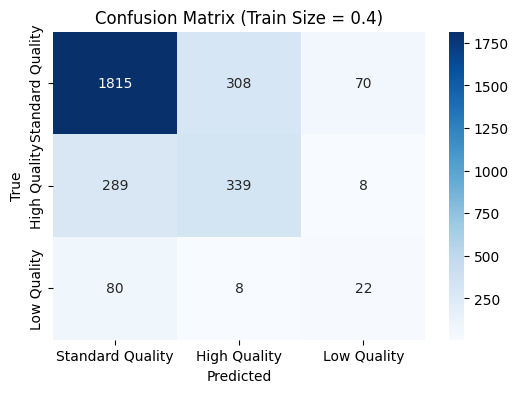


--- Evaluating Decision Tree (Train size = 0.6) ---
Classification Report for Train Size = 0.6:

                  precision    recall  f1-score   support

Standard Quality       0.58      0.61      0.59       424
    High Quality       0.29      0.33      0.31        73
     Low Quality       0.86      0.84      0.85      1463

        accuracy                           0.77      1960
       macro avg       0.58      0.59      0.58      1960
    weighted avg       0.78      0.77      0.78      1960



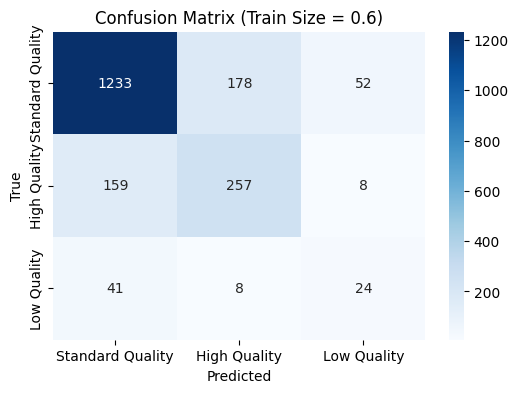


--- Evaluating Decision Tree (Train size = 0.8) ---
Classification Report for Train Size = 0.8:

                  precision    recall  f1-score   support

Standard Quality       0.56      0.58      0.57       212
    High Quality       0.42      0.41      0.41        37
     Low Quality       0.86      0.85      0.85       731

        accuracy                           0.78       980
       macro avg       0.61      0.61      0.61       980
    weighted avg       0.78      0.78      0.78       980



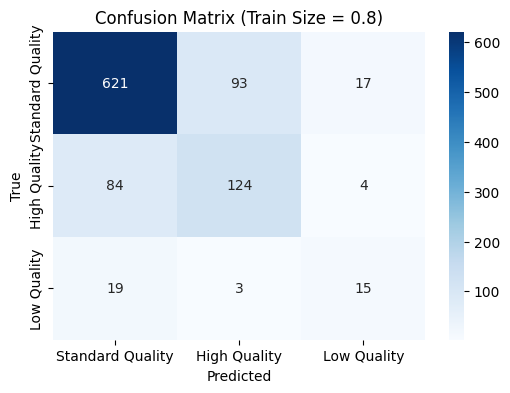


--- Evaluating Decision Tree (Train size = 0.9) ---
Classification Report for Train Size = 0.9:

                  precision    recall  f1-score   support

Standard Quality       0.60      0.64      0.62       106
    High Quality       0.39      0.39      0.39        18
     Low Quality       0.87      0.85      0.86       366

        accuracy                           0.79       490
       macro avg       0.62      0.63      0.62       490
    weighted avg       0.79      0.79      0.79       490



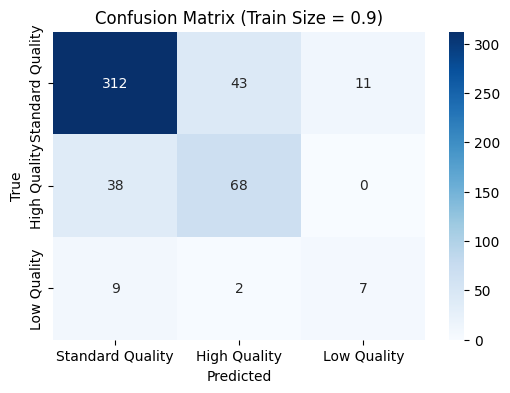

In [81]:
# Evaluate decision trees for each dataset split
for dataset in datasets:
    train_size_str = f"{dataset['train_size']}"  # Retrieve the key for the classifier
    clf = trained_classifiers[train_size_str]  # Retrieve the trained classifier
    
    # Evaluate the trained classifier on the test set
    print(f"\n--- Evaluating Decision Tree (Train size = {dataset['train_size']}) ---")
    evaluate_decision_tree(clf, dataset['feature_test'], dataset['label_test'], dataset['train_size'])

### *The depth and accuracy of a decision tree*

In [82]:
# Folder to save decision tree images for different depths
output_folder = "WQ_dataset_decision_trees/max_depth_trees"
os.makedirs(output_folder, exist_ok=True)

In [83]:
# Values for max_depth
depth_values = [None, 2, 3, 4, 5, 6, 7]
accuracy_results = []

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.931198 to fit


Decision Tree (max_depth=None):


Decision Tree (max_depth=2):


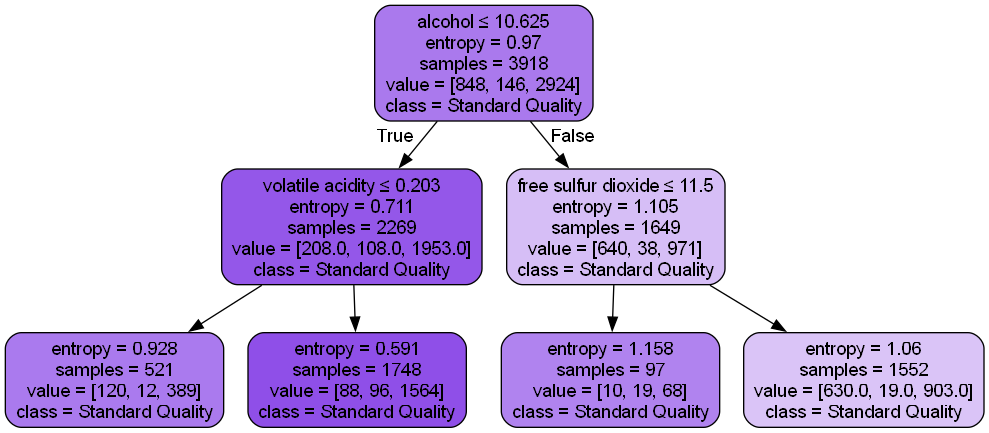

Decision Tree (max_depth=3):


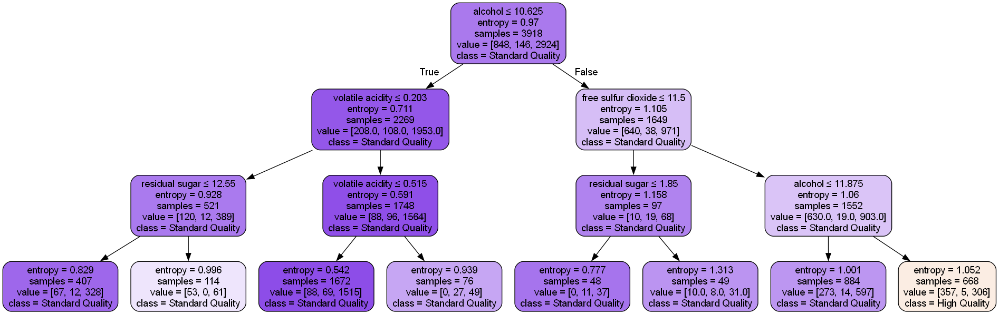

Decision Tree (max_depth=4):


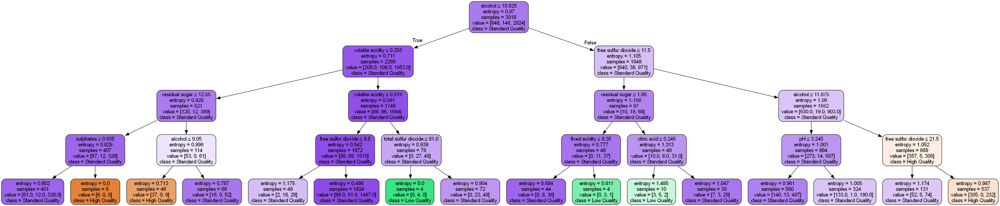

Decision Tree (max_depth=5):


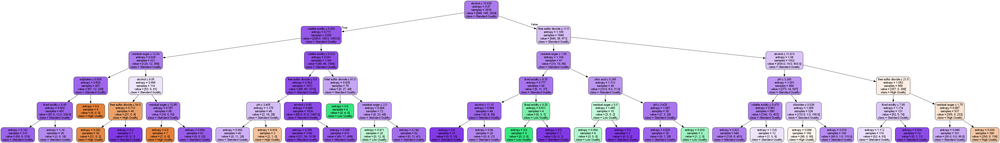

Decision Tree (max_depth=6):


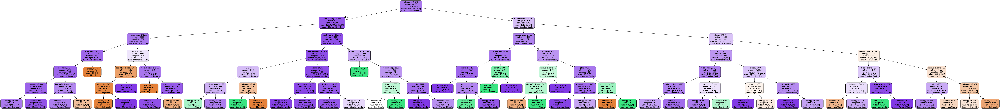

Decision Tree (max_depth=7):


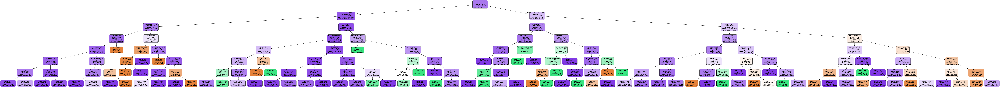

In [84]:
# Train and evaluate decision trees for different depths
dataset = None
for d in datasets:
    if d['train_size'] == 0.8:
        dataset = d
        break

# Ensure that we found the dataset with 80/20 split
if dataset is None:
    raise ValueError("No dataset found with 80/20 train-test split.")

for max_depth in depth_values:
    # Train the decision tree
    clf = DecisionTreeClassifier(criterion="entropy", random_state=42, max_depth=max_depth)
    clf.fit(dataset['feature_train'], dataset['label_train'])  # Train using current dataset

    # Predict and calculate accuracy
    predictions = clf.predict(dataset['feature_test'])
    accuracy = accuracy_score(dataset['label_test'], predictions)
    accuracy_results.append(accuracy)
    
    # Sort the class names to match their internal order in the tree
    sorted_class_names = sorted(label_train.unique())

    # Visualize the decision tree
    dot_data = export_graphviz(
        clf,
        out_file=None,
        feature_names=dataset['feature_train'].columns,
        class_names=sorted_class_names,
        filled=True,
        rounded=True,
        special_characters=True
    )
    graph = Source(dot_data)
    image_path = os.path.join(output_folder, f"DecisionTree_maxDepth_{max_depth}")
    graph.render(image_path, format='png', cleanup=True)

    # Display the tree in the notebook
    print(f"Decision Tree (max_depth={max_depth}):")
    display(Image(filename=image_path + ".png", width=1300))

In [85]:
# Create a table of accuracies for each max_depth value
accuracy_table = pd.DataFrame({
    "max_depth": ["None" if d is None else d for d in depth_values],
    "Accuracy": accuracy_results
})
display(accuracy_table)

,max_depth,Accuracy
0,None,0.775510
1,2,0.745918
2,3,0.761224
3,4,0.772449
4,5,0.781633
5,6,0.786735
6,7,0.787755


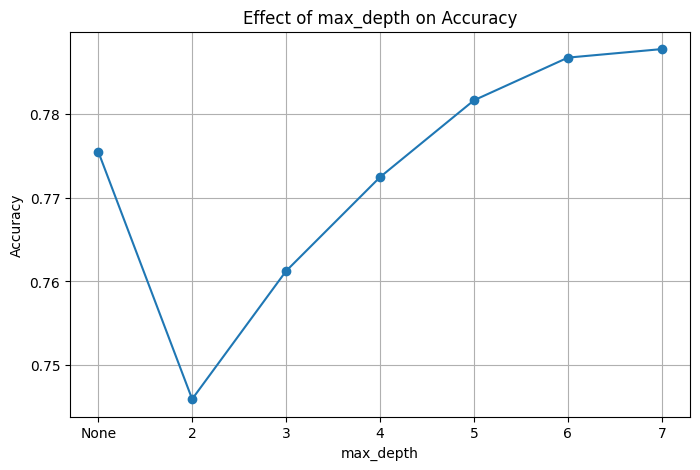

In [86]:
# Plot accuracy scores for different max_depth values
plt.figure(figsize=(8, 5))
plt.plot(["None" if d is None else d for d in depth_values], accuracy_results, marker="o")
plt.title("Effect of max_depth on Accuracy")
plt.xlabel("max_depth")
plt.ylabel("Accuracy")
plt.grid(True)
plt.show()